<a href="https://colab.research.google.com/github/DomMc97/Applied-Maths-MSc-Thesis/blob/master/docs/Cluster%20Visualisations/Hierarchy.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Hiearchy

Creates Sankey plots and quantifies hierarchy.

## Mount Drive

In [ ]:
# mount Google Drive
from google.colab import drive
drive.mount('/content/drive')
root = '/content/drive/My Drive/Project/'

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive


## Libraries

In [ ]:
import numpy as np
import pandas as pd

import holoviews as hv
from holoviews import opts

import branca.colormap as cm
import matplotlib.colors as colors

from string import ascii_uppercase

# import classes
import sys
sys.path.append(root + 'Classes')
from Stability_class import Stability

In [ ]:
%%capture
# load MSOAs
# geopandas import
!pip install geopandas
import geopandas as gpd

## Data Processing

Load in data for processing.

In [ ]:
stability_data = Stability(root + 'Stability Data/longrun.mat')

# N x T array of cluster labels.
C = stability_data.C
# Array of number of communities.
k = stability_data.k
# Array of Markov times
times = stability_data.t

Assigns chosen times and converts times to 4 s.f.

In [ ]:
# Markov Times to 4 s.f
my_times = [7.499e3,3.350e3,188.4,19.95,0.5623]

# function which converts array to 4.s.f
def sf4(x):
    x = float(np.format_float_positional(x, precision=4, unique=False,
                                         fractional=False))
    return x
vec_sf4 = np.vectorize(sf4)

# convert tp 4 s.f
times = vec_sf4(times)

Gets labels at the chosen times and assigns each label with a color.

In [ ]:
labels_lst = []
cmaps = []
my_k = []
for time in my_times:
    # gets index 
    idx = int(np.where(times == float(time))[0][0])

    # number of communities
    n = k[idx]

    # labels
    labels = C[:, idx]

    #creates categorical colour map
    catcolormap = cm.linear.Spectral_11.to_step(index=np.arange(-0.5,n))

    hex_map = []
    for color in catcolormap.colors:
        hex_map.append(colors.rgb2hex(color))
    
    # add results to lists.
    labels_lst.append(labels)
    cmaps.append(hex_map)
    my_k.append(n)

Create Color Map.

In [ ]:
colormap = {}
for i, cmap in enumerate(cmaps):
    for j in range(len(cmap)):
      cat = ascii_uppercase[i] + '_' + str(j)
      colormap[cat] = cmap[j]

Create dataframe for Sankey plot.

In [ ]:
data = {'source':[],'target':[],'count':[]}
for idx in range(len(labels_lst)-1):
    # labels to compare 
    arr1 = labels_lst[idx]
    arr2 = labels_lst[idx + 1]
    # sources
    for source_idx in range(my_k[idx]):
        source = ascii_uppercase[idx] + '_' + str(source_idx)
        # targets
        for target_idx in range(my_k[idx + 1]):
            # add source
            data['source'].append(source)
            
            # add target                      
            target = ascii_uppercase[idx + 1] + '_' + str(target_idx)
            data['target'].append(target)
            
            # get count of source to target
            # match source
            source_bool = (arr1 == source_idx)
            # match target
            target_bool = (arr2 == target_idx)
            # match both
            match_bool = np.logical_and(source_bool, target_bool)
            count = np.count_nonzero(match_bool)
            data['count'].append(count)

data = pd.DataFrame(data)
data.head()

,source,target,count
0,A_0,B_0,0
1,A_0,B_1,0
2,A_0,B_2,0
3,A_0,B_3,0
4,A_0,B_4,516


## Sankey Plot

Create a Sankey plot from the data.

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
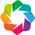

:Sankey   [source,target]   (count)

In [ ]:
hv.extension('bokeh')
renderer = hv.renderer('bokeh')
sankey = hv.Sankey(data)
sankey.opts(cmap=colormap,label_position='right',edge_line_width=0,
            edge_color="source",node_sort=True, node_alpha=1.0, node_width=20,
            show_values=False,width=1840, height=2600,padding=0,margin=0,
            tools=['pan','box_zoom','save','reset'],
            toolbar='left')
sankey

Save plot.

In [ ]:
renderer.save(sankey, root + 'Plots/Sankey')

Create a Sankey plot with a minimum display width to make all connections visible.

In [ ]:
hv.extension('bokeh')
renderer = hv.renderer('bokeh')
sankey = hv.Sankey(data)
sankey.opts(cmap=colormap,label_position='right',edge_line_width=0.01,
            edge_color="source",node_sort=True, node_alpha=1.0, node_width=20,
            show_values=False,width=1840, height=2600,padding=0,margin=0,
            tools=['pan','box_zoom','save','reset'],
            toolbar='left')
sankey

## Calculate Conecentrations Clusters

Calculation of the concentration of clusters for a transition. e.g if cluster $B_{1}$ compromises of MSOAs which were all in cluster $A_{1}$ it's concentration would be 1. If it is comprised of MSOAs half of which were in $A_1$ and half in $A_2$ it's concentration would be $\frac{0.5^{2} + 0.5^{2}}{2} = 0.25$.  

In [ ]:
# array of targets
targets = data['target'].values

# function to calculate concentrations.
def HHI(x):
    pro = x/sum(x)
    HHI = np.sum(pro**2)
    return HHI

# calculate concentrations
group = data.groupby(['target'])
hhis = group.agg(HHI)
hhis.columns = ['HHI']

hhis.head()

,HHI
target,
B_0,0.971692
B_1,1.000000
B_2,1.000000
B_3,1.000000
B_4,0.918299


## Review Results 

Review the concentrations of each partion.

Creates a list of lists of the clusters in partition.

In [ ]:
B_keys = [ascii_uppercase[1] + '_' + str(i) for i in range(9)]
C_keys = [ascii_uppercase[2] + '_' + str(i) for i in range(25)]
D_keys = [ascii_uppercase[3] + '_' + str(i) for i in range(54)]
E_keys = [ascii_uppercase[4] + '_' + str(i) for i in range(148)]
partitions = [B_keys, C_keys, D_keys, E_keys]

Returns top 3 dilute clusters for each partition.

In [ ]:
results = []
for part in partitions:
    results.append(hhis[hhis.index.isin(part)].nsmallest(3,'HHI'))

Clustering B's most dilute clusters.

In [ ]:
results[0].head()

,HHI
target,
B_4,0.918299
B_0,0.971692
B_7,0.995941


Clustering C's most dilute clusters.

In [ ]:
results[1].head()

,HHI
target,
C_5,0.514099
C_2,0.598313
C_19,0.706633


Clustering D's most dilute clusters.

In [ ]:
results[2].head()

,HHI
target,
D_6,0.364292
D_20,0.506584
D_13,0.573964


Clustering E's most dilute clusters.

In [ ]:
results[3].head()

,HHI
target,
E_135,0.457798
E_82,0.542535
E_102,0.575617


## MSOA HHI 

HHI for MSOAs across clusters.

In [ ]:
MSOA_HHI = np.zeros((1, 6790))
for time, part in zip(my_times[1:], partitions):
    # gets index 
    idx = int(np.where(times == float(time))[0][0])

    # labels
    labels = C[:, idx]

    # concentrations of the cluster a node is in
    s_i = hhis[hhis.index.isin(part)]['HHI'].reindex(part)[labels]
    MSOA_HHI += s_i**2
MSOA_HHI = MSOA_HHI/4

100 MSOAs with Lowest HHI 

In [ ]:
top_100 = MSOA_HHI.argsort()[0][:100]

In [ ]:
MSOAs = gpd.read_file(root + 'MSOAs/MSOAs.shp')['msoa11nm']

     |████████████████████████████████| 972kB 2.8MB/s 
     |████████████████████████████████| 14.8MB 278kB/s 
     |████████████████████████████████| 10.9MB 48.3MB/s 


In [ ]:
MSOAs[MSOAs.index.isin(top_100)].reindex(top_100).to_csv(root + 'top_100.csv')

HHI data added to MSOAs

In [ ]:
order = MSOA_HHI.argsort()[0]
MSOAs = pd.DataFrame(MSOAs[MSOAs.index.isin(order)])
MSOAs['HHI'] = MSOA_HHI[0]
MSOAs.sort_values('HHI').to_csv(root + 'ordered.csv')